<a href="https://colab.research.google.com/github/luananova/Transforming-Comics-into-Accessible-Audio-Narratives/blob/main/NOTEBOOKS/Spell_Bubble_Identifying_Characters.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Transforming and saving the image in Base64

In [ ]:
!pip install opencv-python

In [ ]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

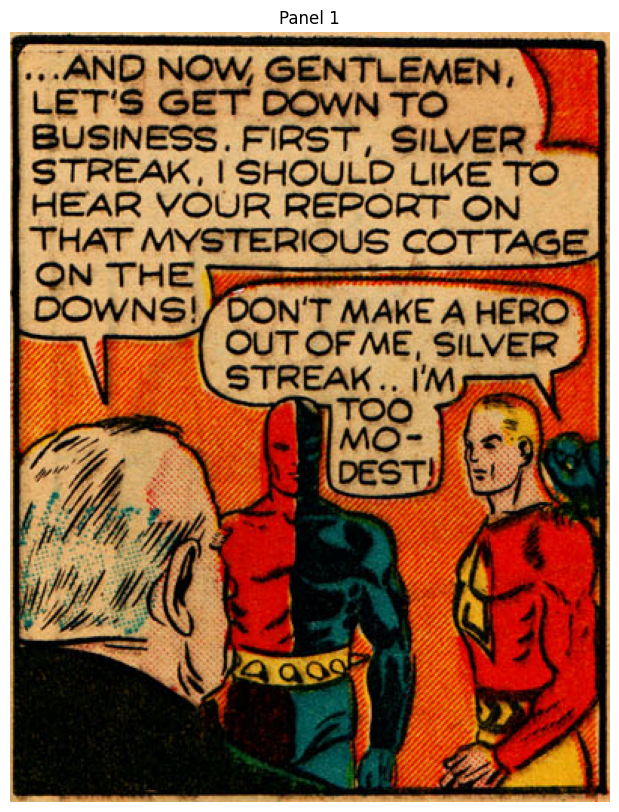

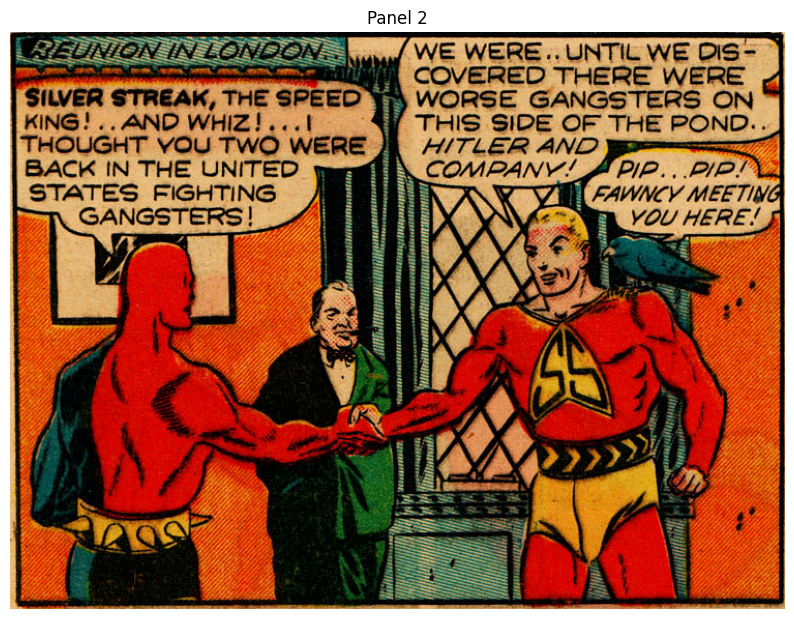

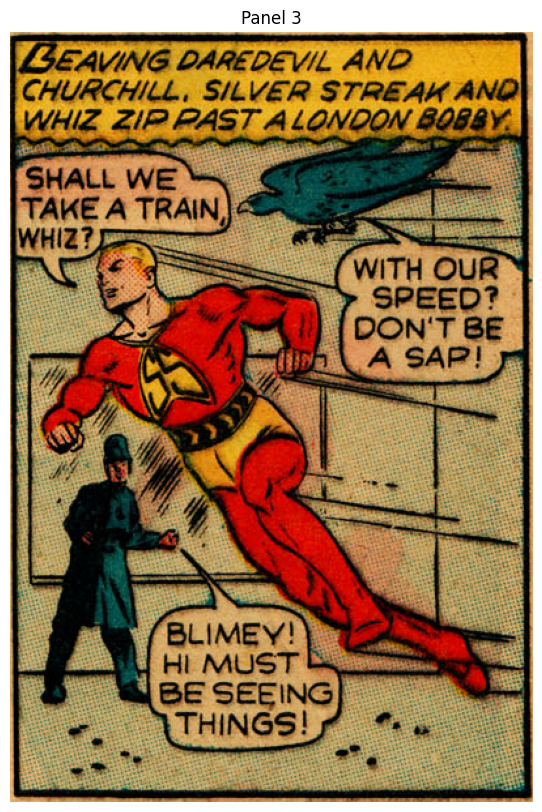

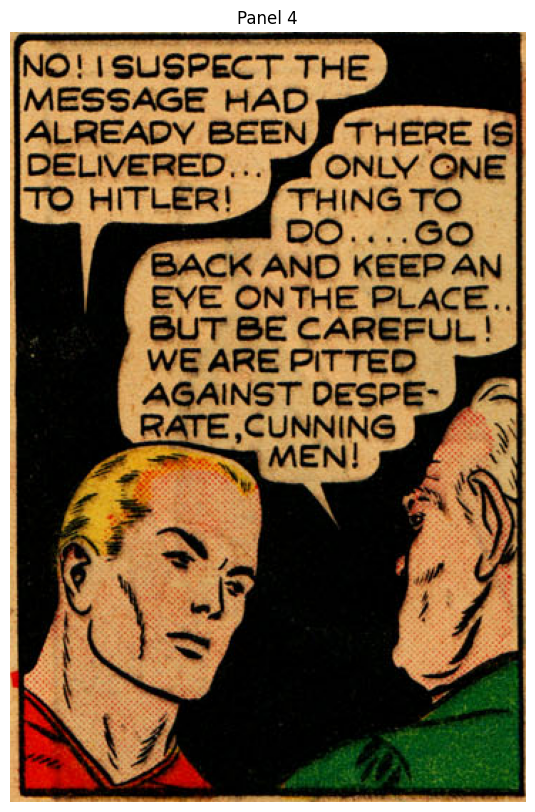

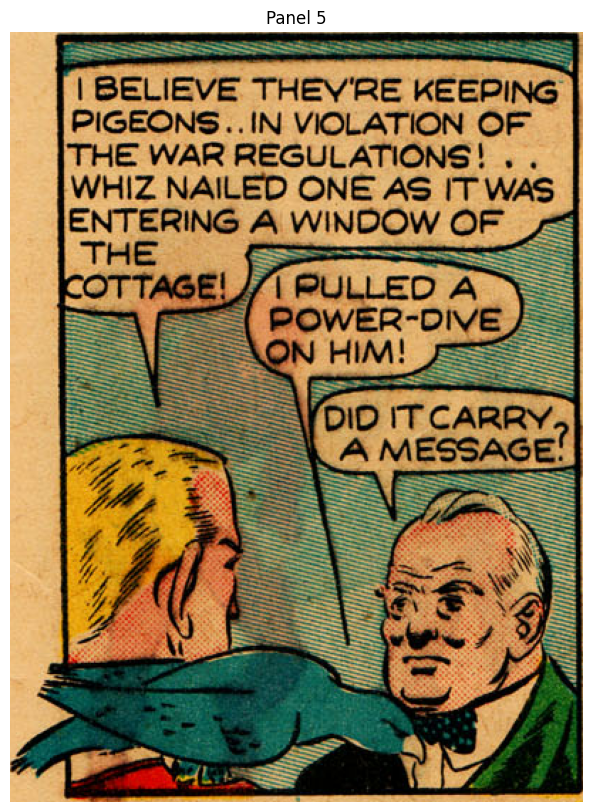

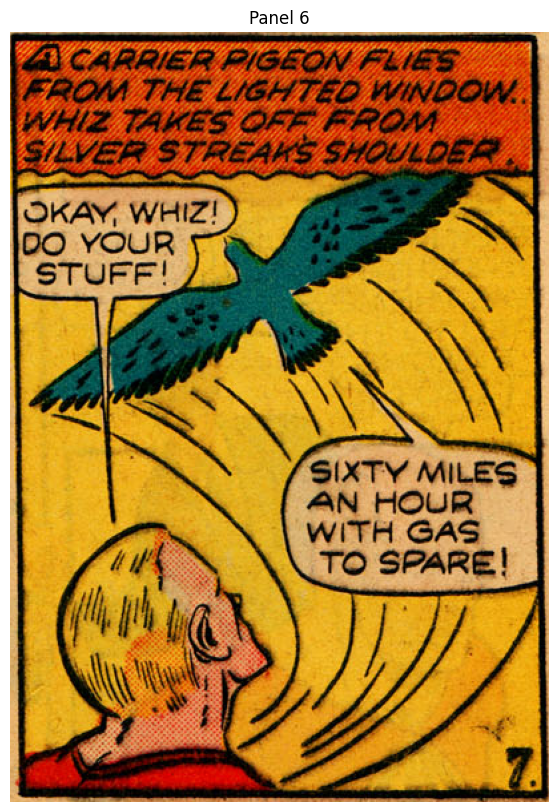

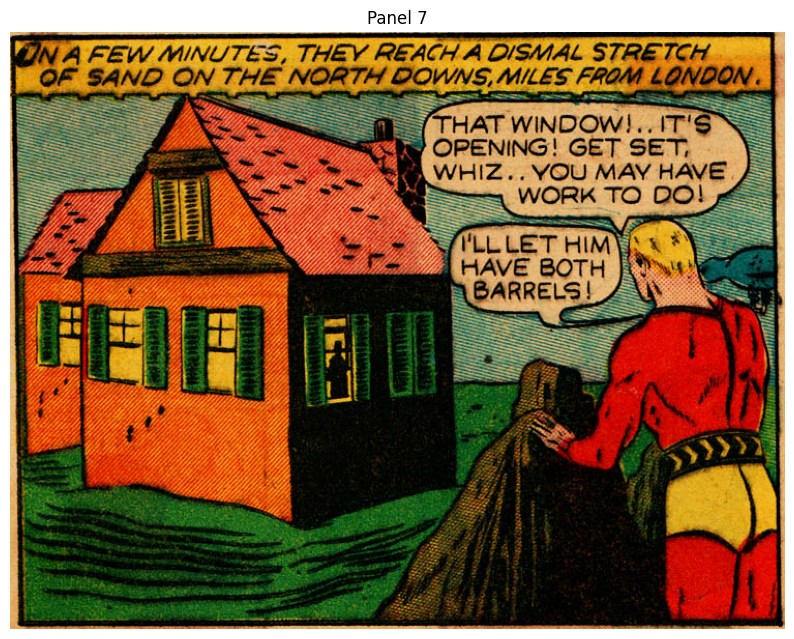

In [ ]:
# Load the image and convert to grayscale
image_path = '/content/Daredevil Battles Hitler 01 (1941) (c2c) (corn) p07.jpg'
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply adaptive thresholding
thresh = cv2.adaptiveThreshold(gray,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV,11,2)

# Find contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Filter contours by area, assuming that too small panels are noise
contours = [c for c in contours if cv2.contourArea(c) > 5000]

# Sort contours by vertical position
contours = sorted(contours, key=lambda c: cv2.boundingRect(c)[1])

panels = []
for contour in contours:
    x, y, w, h = cv2.boundingRect(contour)
    panel = image[y:y+h, x:x+w]
    panels.append(panel)

# Show individual panels
for idx, panel in enumerate(panels, 1):
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(panel, cv2.COLOR_BGR2RGB))
    plt.title(f"Panel {idx}")
    plt.axis('off')
    plt.show()

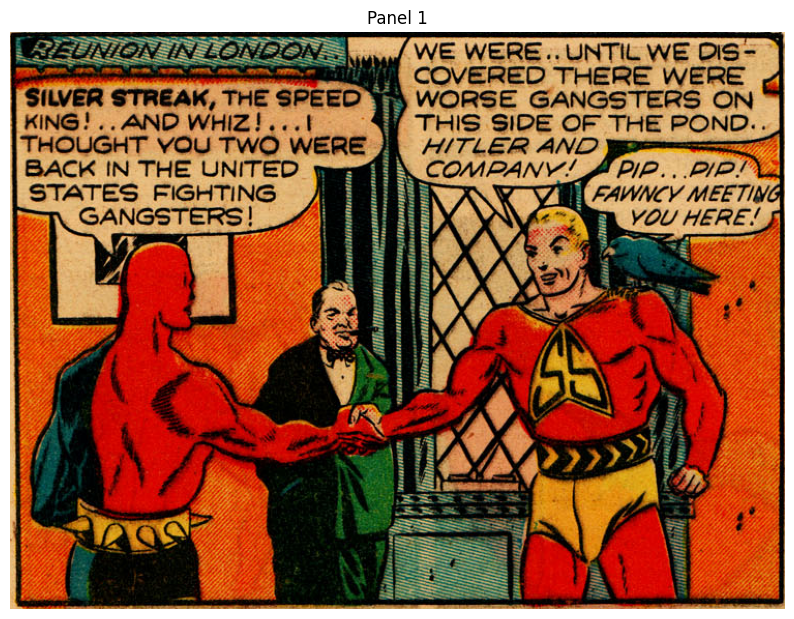

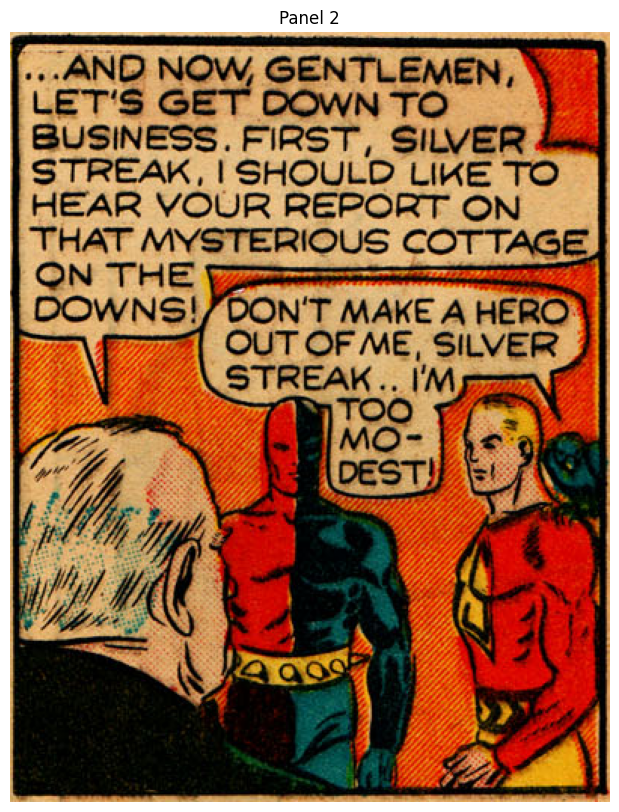

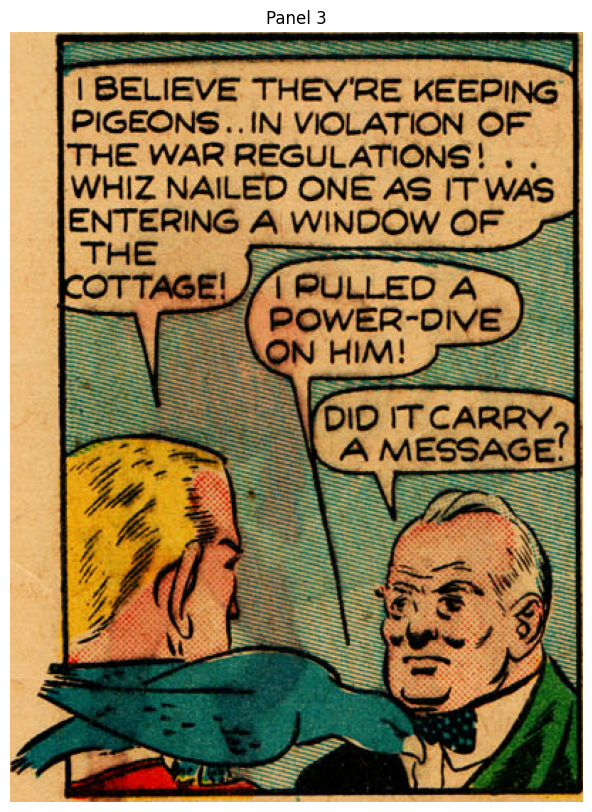

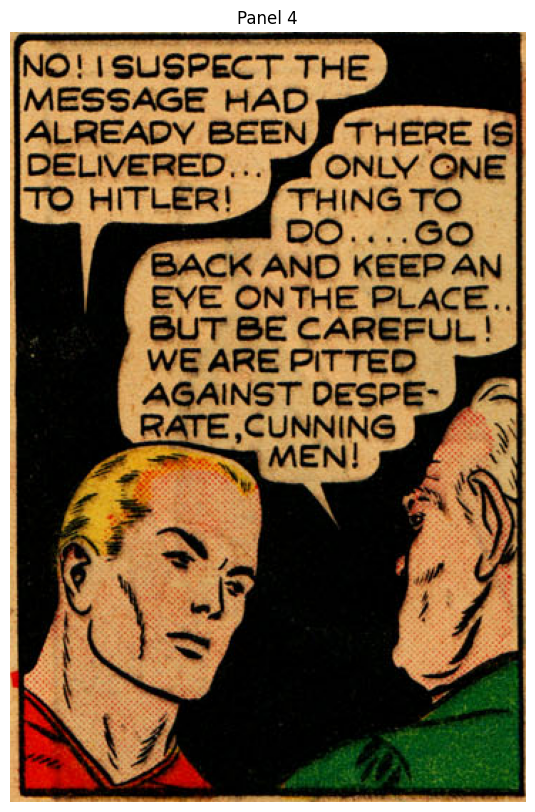

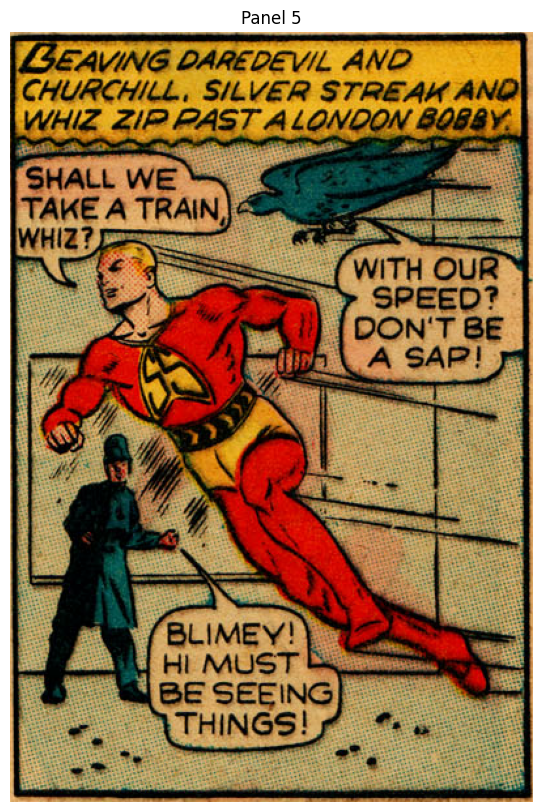

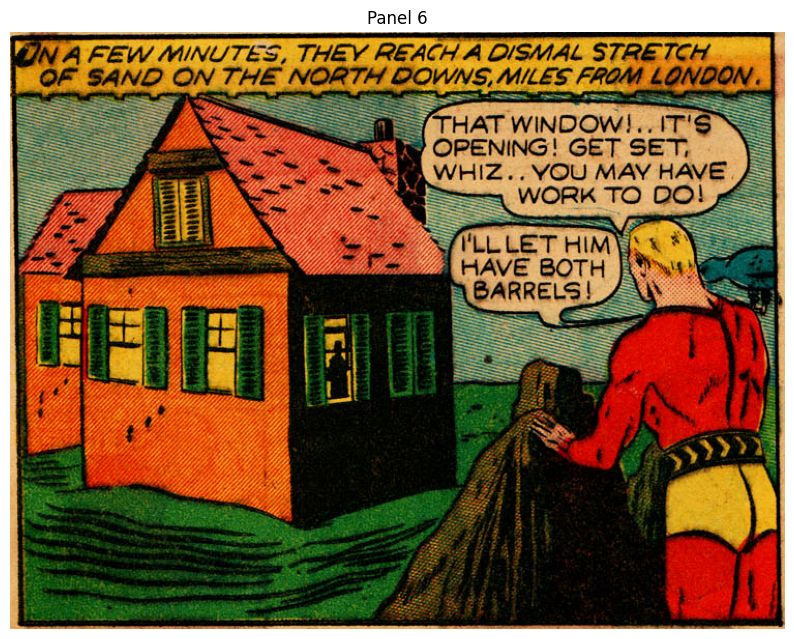

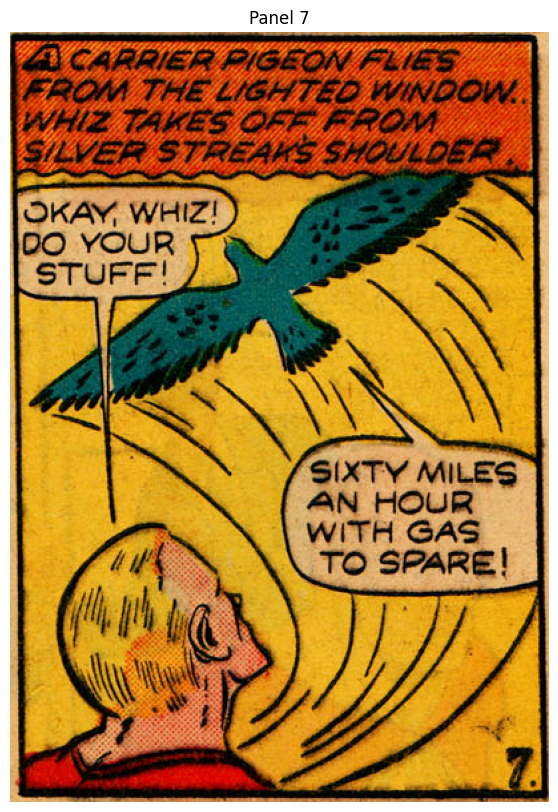

In [ ]:
def sort_panels(contours):
    # Sort contours by vertical position
    sorted_by_y = sorted(contours, key=lambda c: cv2.boundingRect(c)[1])

    # Group panels in the same "line"
    lines = []
    line = []
    prev_y = 0

    for contour in sorted_by_y:
        _, y, _, _ = cv2.boundingRect(contour)

        if not line or abs(y - prev_y) < 50:  # The value of 50 can be adjusted as necessary
            line.append(contour)
        else:
            lines.append(sorted(line, key=lambda c: cv2.boundingRect(c)[0]))  # Sort by horizontal position
            line = [contour]

        prev_y = y

    # Add the last line if it is not empty
    if line:
        lines.append(sorted(line, key=lambda c: cv2.boundingRect(c)[0]))

    # Flatten the list of lines
    sorted_contours = [contour for line in lines for contour in line]

    return sorted_contours

# Apply the sorting function
sorted_contours = sort_panels(contours)

panels = []
for contour in sorted_contours:
    x, y, w, h = cv2.boundingRect(contour)
    panel = image[y:y+h, x:x+w]
    panels.append(panel)

# Show individual panels
for idx, panel in enumerate(panels, 1):
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(panel, cv2.COLOR_BGR2RGB))
    plt.title(f"Panel {idx}")
    plt.axis('off')
    plt.show()


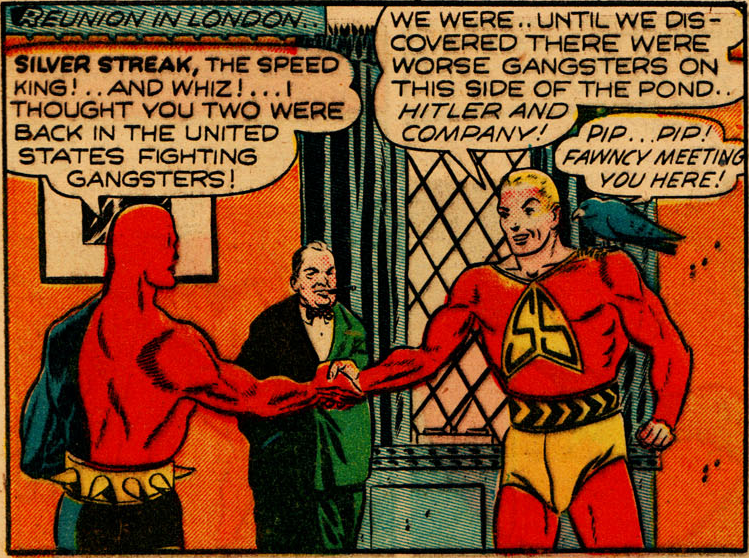


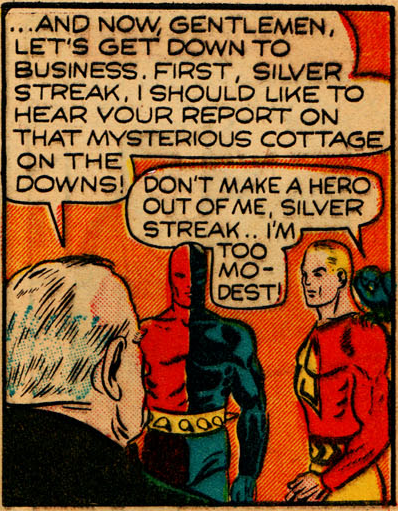


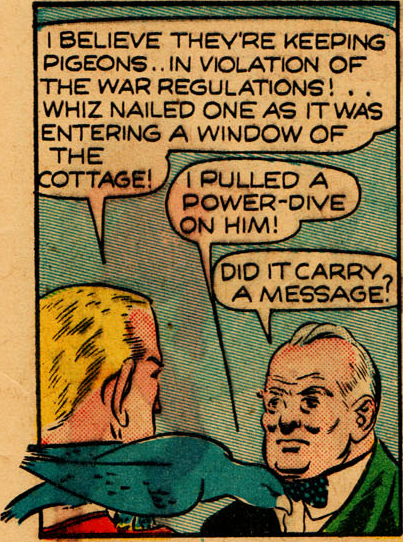


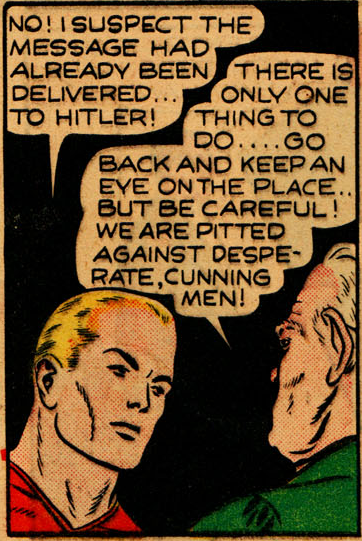


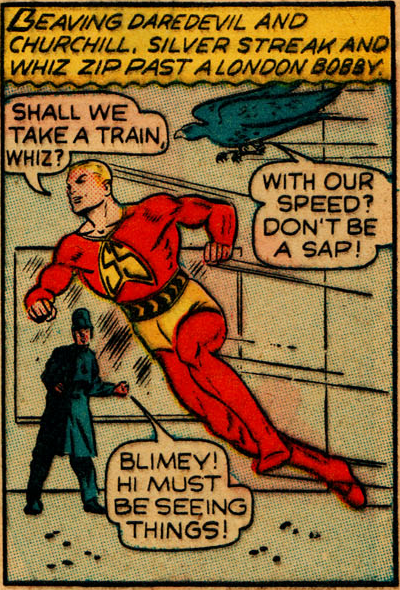


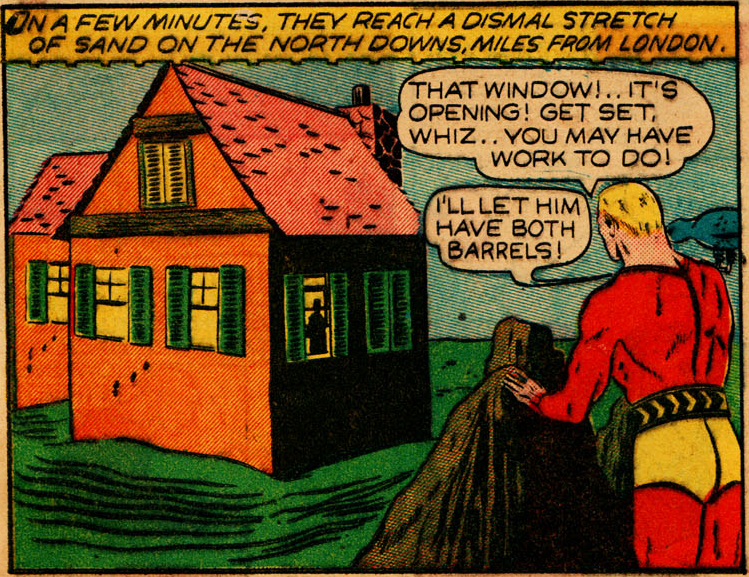


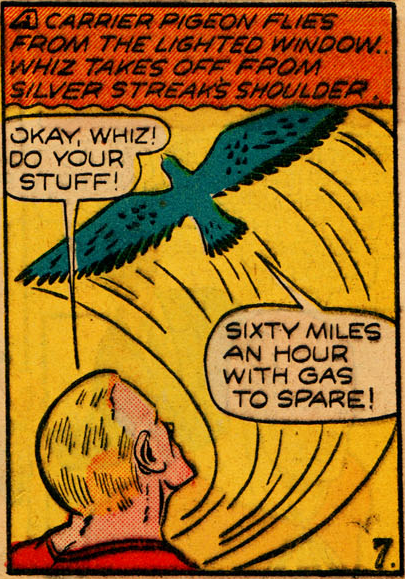

In [ ]:
import base64
from io import BytesIO
from PIL import Image
import IPython

def image_to_base64(image):
    buffered = BytesIO()
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
    pil_image = Image.fromarray(rgb_image)
    pil_image.save(buffered, format="PNG")  # Save as PNG
    return base64.b64encode(buffered.getvalue()).decode()

imagens_base64 = {}
# Display panels as base64 images
for idx, panel in enumerate(panels, 1):
    base64_image = image_to_base64(panel)
    imagens_base64[f"painel{idx}"] = base64_image  # Add the encoded image to the dictionary

    # Display image in the interface
    img_html = f'<img src="data:image/png;base64,{base64_image}" />'
    display(IPython.display.HTML(img_html))

In [ ]:
# Saving the result
import json

with open('imagens_base64.json', 'w') as file:
    json.dump(imagens_base64, file, indent=4)

# Creating an interactive interface with Javascript and HTML


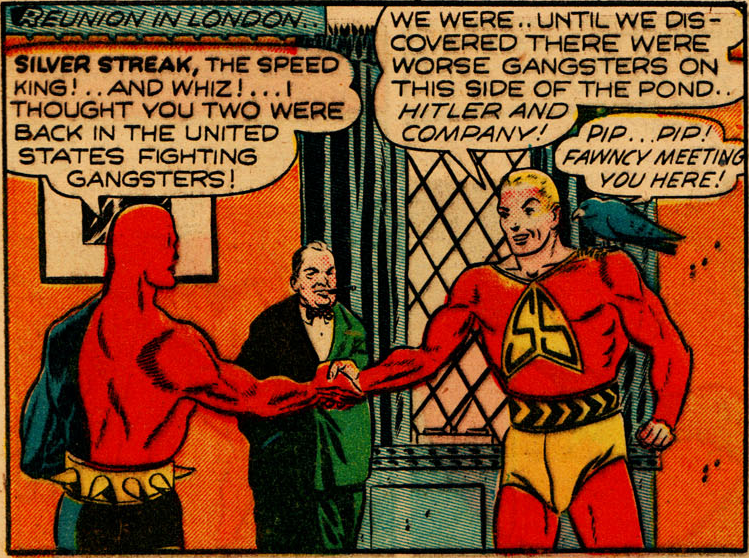


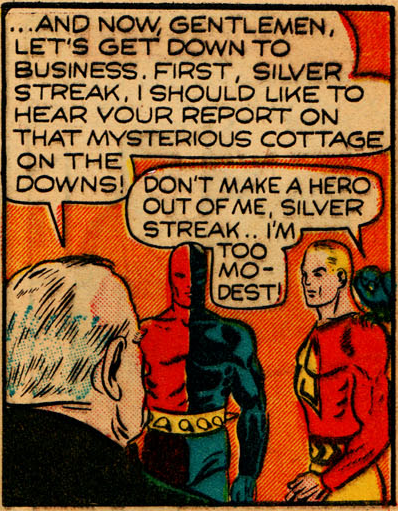


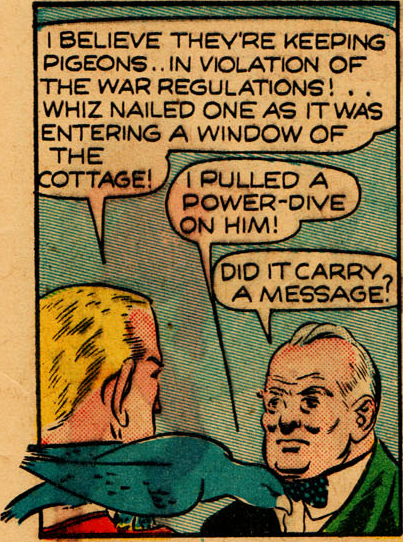


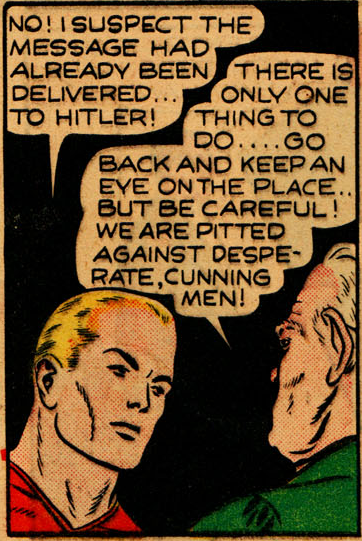


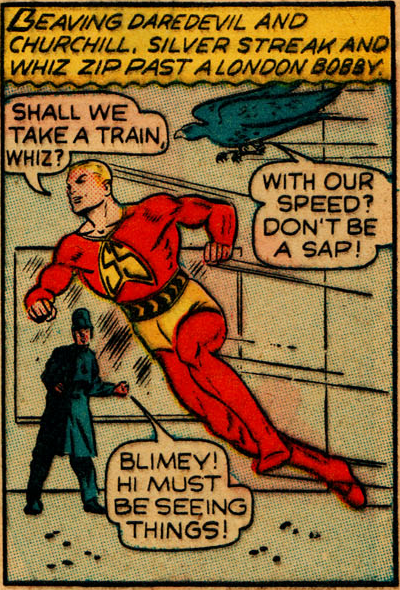


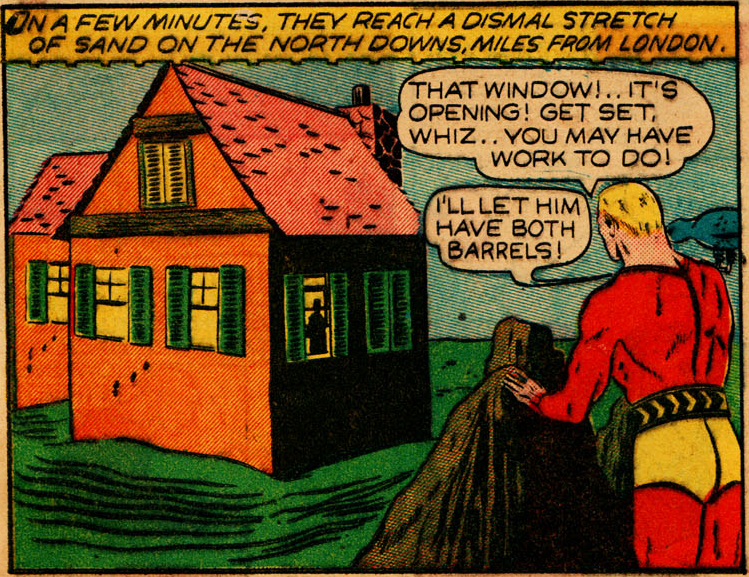


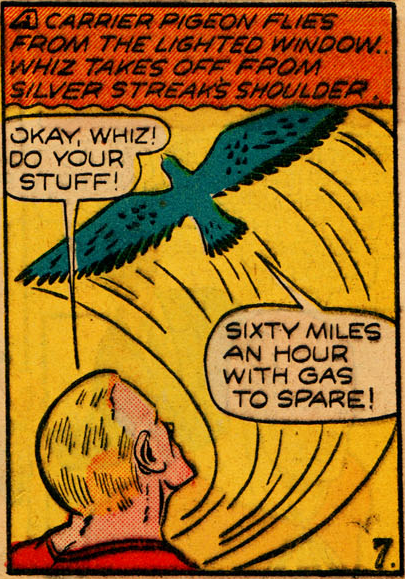

Retângulos do Painel 1 salvos com sucesso.
Retângulos do Painel 2 salvos com sucesso.
Retângulos do Painel 3 salvos com sucesso.
Retângulos do Painel 4 salvos com sucesso.
Retângulos do Painel 5 salvos com sucesso.
Retângulos do Painel 6 salvos com sucesso.
Retângulos do Painel 7 salvos com sucesso.


In [ ]:
from google.colab import output
import ipywidgets as widgets
from IPython.display import display, Javascript

# Initialize the data structure to store annotations
anotacoes = {}

personagens = ['Whiz', 'O Policial', 'Churchill', 'Silver Streak', 'Daredevil']

# Display panels as base64 images with canvas and buttons
for idx, panel in enumerate(panels, 1):
    base64_image = image_to_base64(panel)
    height, width, _ = panel.shape

    html = f"""
    <div id="painel_contêiner{idx}" style="margin-bottom: 20px;">
        <div style="position: relative; width: {width}px; height: {height}px;">
            <img src="data:image/png;base64,{base64_image}" id="painel{idx}" width="{width}px" height="{height}px" style="position: absolute; z-index: 1;">
            <canvas id="canvas{idx}" width="{width}px" height="{height}px" style="position: absolute; z-index: 2;" onmousedown="iniciarDesenho(event, 'canvas{idx}')"></canvas>
        </div>
        <button onclick="salvarCoordenadas('canvas{idx}', {idx})">Salvar Retângulos do Painel {idx}</button>
        <button onclick="resetarCanvas('canvas{idx}')">Recomeçar Retângulos do Painel {idx}</button>
    </div>
    <script>
    var retangulosPorPainel = {{}};

    function iniciarDesenho(e, canvasId) {{
        var canvas = document.getElementById(canvasId);
        var ctx = canvas.getContext('2d');
        var rect = {{ startX: e.offsetX, startY: e.offsetY, x: e.offsetX, y: e.offsetY, w: 0, h: 0 }};
        canvas.onmousemove = (e) => continuarDesenho(e, canvas, rect);
        canvas.onmouseup = () => finalizarDesenho(canvas, rect);
        if (!retangulosPorPainel[canvasId]) {{
            retangulosPorPainel[canvasId] = [];
        }}
        retangulosPorPainel[canvasId].push(rect);
    }}

    function continuarDesenho(e, canvas, rect) {{
        // Calcula a largura e altura provisórias
        let width = e.offsetX - rect.startX;
        let height = e.offsetY - rect.startY;

        // Ajusta o ponto inicial e a largura/altura para garantir valores positivos
        if (width < 0) {{
            rect.x = e.offsetX;
            rect.w = -width;
        }} else {{
            rect.x = rect.startX;
            rect.w = width;
        }}

        if (height < 0) {{
            rect.y = e.offsetY;
            rect.h = -height;
        }} else {{
            rect.y = rect.startY;
            rect.h = height;
        }}

        // Redesenha o canvas com os retângulos atualizados
        redesenhar(canvas);
    }}

    function finalizarDesenho(canvas, rect) {{
        canvas.onmousemove = null;
        canvas.onmouseup = null;
        redesenhar(canvas);
    }}

    function redesenhar(canvas) {{
        var ctx = canvas.getContext('2d');
        ctx.clearRect(0, 0, canvas.width, canvas.height);
        retangulosPorPainel[canvas.id].forEach((rect) => {{
            ctx.strokeRect(rect.x, rect.y, rect.w, rect.h);
        }});
    }}

    function resetarCanvas(canvasId) {{
        var canvas = document.getElementById(canvasId);
        var ctx = canvas.getContext('2d');
        ctx.clearRect(0, 0, canvas.width, canvas.height);
        retangulosPorPainel[canvasId] = [];
    }}

    function salvarCoordenadas(canvasId, painelIndex) {{
        var coordenadasOriginais = retangulosPorPainel[canvasId];
        var coordenadasProcessadas = coordenadasOriginais.map(rect => ({{
            x: rect.x,
            y: rect.y,
            w: rect.w,
            h: rect.h
        }}));

        console.log('Coordenadas do Painel ' + painelIndex + ': ', coordenadasProcessadas);

        // Invocar função Python com as coordenadas processadas
        google.colab.kernel.invokeFunction('notebook.processar_coordenadas', [painelIndex, coordenadasProcessadas], {{}});

        // Chamar função Python para exibir mensagem de sucesso
        google.colab.kernel.invokeFunction('notebook.exibir_mensagem_sucesso', ['Retângulos do Painel ' + painelIndex + ' salvos com sucesso.'], {{}});
    }}
    </script>
    """
    display(IPython.display.HTML(html))

# Function to collect coordinates
def processar_coordenadas(painel_index, coordenadas):
    if painel_index not in anotacoes:
        anotacoes[painel_index] = coordenadas
    else:
        anotacoes[painel_index].extend(coordenadas)

output.register_callback('notebook.processar_coordenadas', processar_coordenadas)

def exibir_mensagem_sucesso(mensagem):
    print(mensagem)

output.register_callback('notebook.exibir_mensagem_sucesso', exibir_mensagem_sucesso)

In [ ]:
def exibir_widgets_selecao():
    for painel_index, rects in anotacoes.items():
        for idx, rect in enumerate(rects):
            display(widgets.HTML(value=f"<b>Retângulo {idx+1} no Painel {painel_index}:</b>"))
            local_dropdown = widgets.Dropdown(options=personagens)
            falou_checkbox = widgets.Checkbox(value=False, description='Falou?')

            # Captures the current state of 'panel_index', 'idx', 'rect', 'local_dropdown', and 'falou_checkbox'
            def criar_on_confirmar_clicked(painel_index, idx, rect, dropdown, checkbox):
                def on_confirmar_clicked(b):
                    personagem_selecionado = dropdown.value
                    rect['personagem'] = personagem_selecionado
                    rect['falou'] = checkbox.value
                    b.disabled = True
                    print(f"Personagem '{personagem_selecionado}' associado ao Retângulo {idx+1} do Painel {painel_index}. Falou: {'Sim' if checkbox.value else 'Não'}.")
                return on_confirmar_clicked

            botao_confirmar = widgets.Button(description="Confirmar Seleção")
            botao_confirmar.on_click(criar_on_confirmar_clicked(painel_index, idx, rect, local_dropdown, falou_checkbox))
            display(widgets.HBox([local_dropdown, falou_checkbox]))
            display(botao_confirmar)

exibir_widgets_selecao()

HTML(value='<b>Retângulo 1 no Painel 1:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 1:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 3 no Painel 1:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 4 no Painel 1:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 2:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 2:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 3 no Painel 2:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 4 no Painel 2:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 3:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 3:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 3 no Painel 3:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 4:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 4:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 5:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 5:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 3 no Painel 5:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 6:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 6:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 1 no Painel 7:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

HTML(value='<b>Retângulo 2 no Painel 7:</b>')

Button(description='Confirmar Seleção', style=ButtonStyle())

Personagem 'Daredevil' associado ao Retângulo 1 do Painel 1. Falou: Sim.
Personagem 'Churchill' associado ao Retângulo 2 do Painel 1. Falou: Não.
Personagem 'Silver Streak' associado ao Retângulo 3 do Painel 1. Falou: Sim.
Personagem 'Whiz' associado ao Retângulo 4 do Painel 1. Falou: Sim.
Personagem 'Churchill' associado ao Retângulo 1 do Painel 2. Falou: Sim.
Personagem 'Daredevil' associado ao Retângulo 2 do Painel 2. Falou: Não.
Personagem 'Silver Streak' associado ao Retângulo 3 do Painel 2. Falou: Não.
Personagem 'Whiz' associado ao Retângulo 4 do Painel 2. Falou: Sim.
Personagem 'Silver Streak' associado ao Retângulo 1 do Painel 3. Falou: Sim.
Personagem 'Whiz' associado ao Retângulo 2 do Painel 3. Falou: Sim.
Personagem 'Churchill' associado ao Retângulo 3 do Painel 3. Falou: Sim.
Personagem 'Silver Streak' associado ao Retângulo 1 do Painel 4. Falou: Sim.
Personagem 'Churchill' associado ao Retângulo 2 do Painel 4. Falou: Sim.
Personagem 'Silver Streak' associado ao Retângulo 

In [ ]:
botao_salvar_anotacoes = widgets.Button(description="Salvar Anotações")

def salvar_anotacoes_json(b=None):
    import json
    arquivo = 'anotacoes.json'
    with open(arquivo, 'w') as f:
        json.dump(anotacoes, f)
    print(f"Anotações salvas com sucesso em '{arquivo}'.")

botao_salvar_anotacoes.on_click(salvar_anotacoes_json)
display(botao_salvar_anotacoes)

Button(description='Salvar Anotações', style=ButtonStyle())

Anotações salvas com sucesso em 'anotacoes.json'.
